In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import warnings
import seaborn as sns

plt.style.use('seaborn')
sns.set_palette('cubehelix')
plt.rcParams['figure.figsize'] = [8, 4.5]
plt.rcParams['figure.dpi'] = 300
warnings.simplefilter(action='ignore', category=FutureWarning)

# Práctica Asset Allocation

## Evaluamos portfolio con igual peso para cda activo 1/n

1. Import librerias:

In [3]:
import yfinance as yf
import numpy as np
import pandas as pd
import pyfolio as pf

/opt/anaconda3/lib/python3.9/site-packages/pyfolio/pos.py:26: UserWarning: Module "zipline.assets" not found; multipliers will not be applied to position notionals.
  warnings.warn(


#### 2. Set up the parameters: Inclñuimos 3 acciones ('AAPL', 'IBM', 'MSFT') el indice SP500 y un índice de Volatilidad

In [4]:
RISKY_ASSETS = ['AAPL', 'IBM', 'MSFT', 'SPY', '^VIX']
START_DATE = '2018-01-01'
END_DATE = '2019-12-31'

n_assets = len(RISKY_ASSETS)

3. Download the stock prices from Yahoo Finance:

[*********************100%***********************]  5 of 5 completed
Downloaded 502 rows of data.


<AxesSubplot:title={'center':'Stock prices of the considered assets'}, xlabel='Date'>

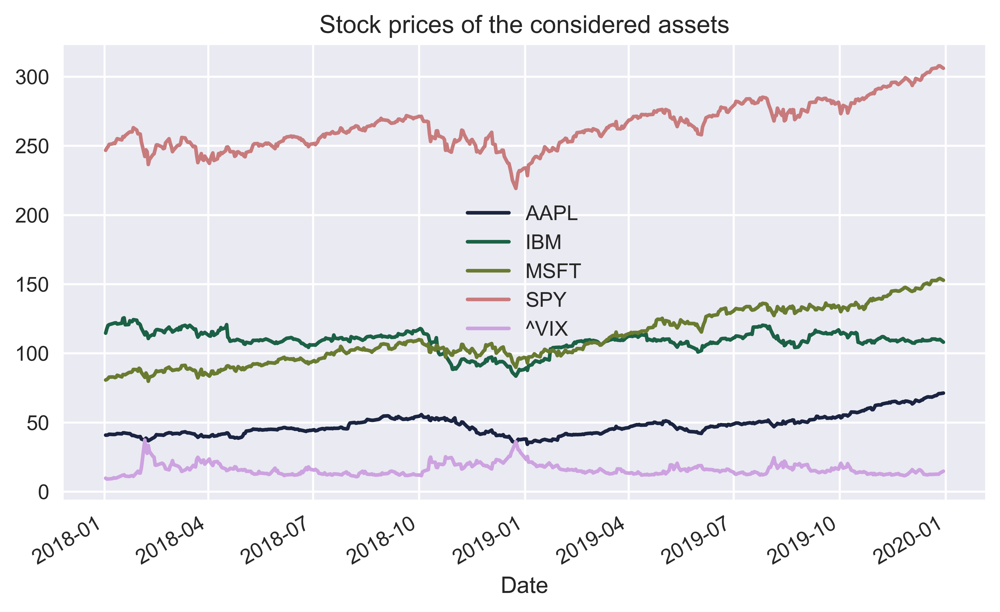

In [5]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE)
print(f'Downloaded {prices_df.shape[0]} rows of data.')
prices_df['Adj Close'].plot(title='Stock prices of the considered assets')

4. Calculate individual asset returns:

In [6]:
returns = prices_df['Adj Close'].pct_change().dropna()

In [7]:
returns

,AAPL,IBM,MSFT,SPY,^VIX
Date,,,,,
2018-01-03,-0.000174,0.027488,0.004654,0.006325,-0.063460
2018-01-04,0.004645,0.020254,0.008802,0.004215,0.007650
2018-01-05,0.011385,0.004886,0.012398,0.006664,0.000000
2018-01-08,-0.003714,0.006031,0.001021,0.001829,0.032538
2018-01-09,-0.000115,0.002203,-0.000680,0.002263,0.058823
...,...,...,...,...,...
2019-12-23,0.016318,-0.000295,0.000000,0.001528,0.007994
2019-12-24,0.000951,-0.004205,-0.000191,0.000031,0.004758
2019-12-26,0.019840,-0.000519,0.008197,0.005323,-0.001579


5. Define the weights:

In [14]:
portfolio_weights = n_assets * [1 / n_assets]

6. Calculate portfolio returns:

In [19]:
portfolio_returns = pd.Series(np.dot(portfolio_weights, returns.T), 
                              index=returns.index)

In [20]:
portfolio_returns

Date
2018-01-03   -0.005033
2018-01-04    0.009113
2018-01-05    0.007067
2018-01-08    0.007541
2018-01-09    0.012499
                ...   
2019-12-23    0.005109
2019-12-24    0.000269
2019-12-26    0.006253
2019-12-27    0.013106
2019-12-30    0.015423
Length: 501, dtype: float64

7. Create the tear sheet (simple variant):

In [21]:
pf.create_simple_tear_sheet(portfolio_returns)

Start date,2018-01-03
End date,2019-12-30
Total months,23
,Backtest
Annual return,46.625%
Cumulative returns,114.011%
Annual volatility,23.307%
Sharpe ratio,1.75
Calmar ratio,4.59
Stability,0.93
Max drawdown,-10.163%


### There's more

In [22]:
pf.create_returns_tear_sheet(portfolio_returns)

Start date,2018-01-03
End date,2019-12-30
Total months,23
,Backtest
Annual return,46.625%
Cumulative returns,114.011%
Annual volatility,23.307%
Sharpe ratio,1.75
Calmar ratio,4.59
Stability,0.93
Max drawdown,-10.163%


Worst drawdown periods,Net drawdown in %,Peak date,Valley date,Recovery date,Duration
0,10.16,2018-10-11,2019-01-11,2019-03-22,117
1,8.81,2018-02-05,2018-04-27,2018-08-10,135
2,5.75,2019-10-08,2019-10-30,2019-12-02,40
3,5.70,2019-05-08,2019-05-22,2019-06-26,36
4,4.02,2019-08-05,2019-08-08,2019-08-30,20


## Finding the Efficient Frontier using Monte Carlo simulations

### How to do it...

1. Import the libraries:

In [8]:
import yfinance as yf
import numpy as np
import pandas as pd

2. Set up the parameters:

In [9]:
N_PORTFOLIOS = 10 ** 5
N_DAYS = 252
#RISKY_ASSETS = ['FB', 'TSLA', 'TWTR', 'MSFT']
RISKY_ASSETS = ['AAPL', 'IBM', 'MSFT', 'SPY', 'TWTR']
RISKY_ASSETS.sort()
START_DATE = '2018-01-01'
END_DATE = '2019-12-31'

n_assets = len(RISKY_ASSETS)

3. Download the stock prices from Yahoo Finance:

In [10]:
prices_df = yf.download(RISKY_ASSETS, start=START_DATE, 
                        end=END_DATE)
print(f'Downloaded {prices_df.shape[0]} rows of data.')

[*********************100%***********************]  5 of 5 completed
Downloaded 502 rows of data.


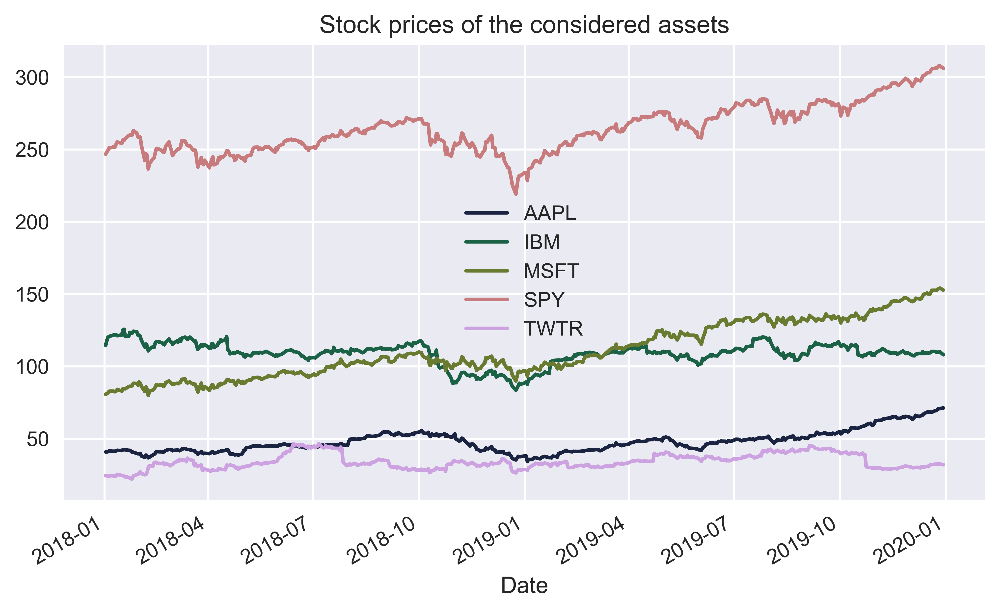

In [11]:
prices_df['Adj Close'].plot(title='Stock prices of the considered assets');

4. Calculate annualized average returns and the corresponding standard deviation:

In [12]:
returns_df = prices_df['Adj Close'].pct_change().dropna()

avg_returns = returns_df.mean() * N_DAYS
cov_mat = returns_df.cov() * N_DAYS

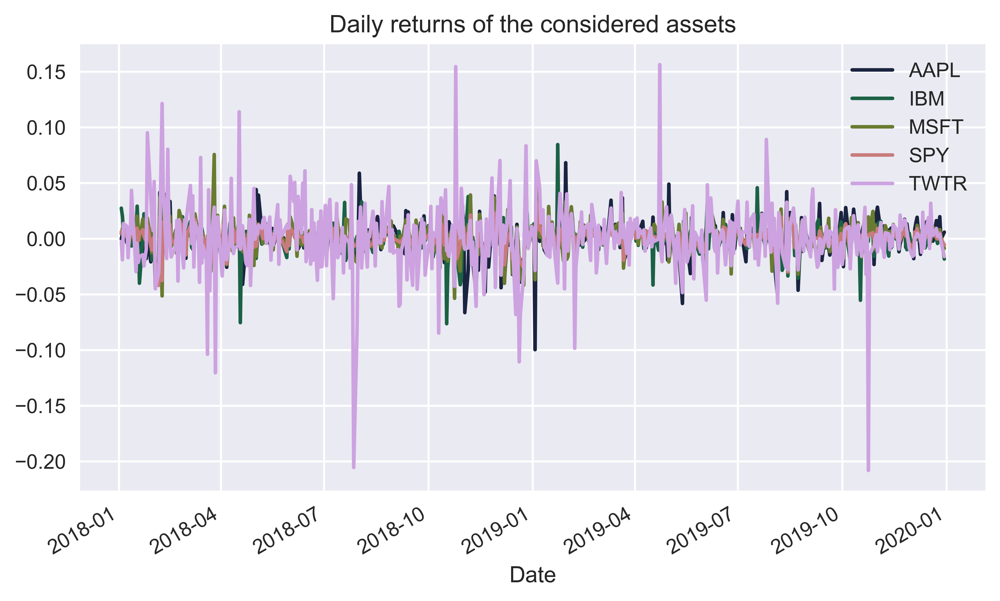

In [13]:
returns_df.plot(title='Daily returns of the considered assets');

5. Simulate random portfolio weights:

In [98]:
np.random.seed(42)
weights = np.random.random(size=(N_PORTFOLIOS, n_assets))
weights /=  np.sum(weights, axis=1)[:, np.newaxis]

In [99]:
weights

array([[0.13319703, 0.33810082, 0.26031769, 0.21289984, 0.05548463],
       [0.06528492, 0.02430844, 0.36250145, 0.25157131, 0.29633388],
       [0.00928442, 0.43746759, 0.37546445, 0.09577331, 0.08201023],
       ...,
       [0.20159568, 0.1276073 , 0.23897949, 0.25821686, 0.17360066],
       [0.06162576, 0.23687072, 0.20328404, 0.22043154, 0.27778794],
       [0.19378302, 0.288101  , 0.14201812, 0.19362775, 0.18247011]])

6. Calculate portfolio metrics:

In [100]:
portf_rtns = np.dot(weights, avg_returns)

# la desv standard es: Wt SUMW 
portf_vol = []
for i in range(0, len(weights)):
    portf_vol.append(np.sqrt(np.dot(weights[i].T, 
                                    np.dot(cov_mat, weights[i]))))
portf_vol = np.array(portf_vol)  
portf_sharpe_ratio = portf_rtns / portf_vol

7. Create a joint DataFrame with all data:

In [101]:
portf_results_df = pd.DataFrame({'returns': portf_rtns,
                                 'volatility': portf_vol,
                                 'sharpe_ratio': portf_sharpe_ratio})

8. Locate the points creating the Efficient Frontier:

In [102]:
N_POINTS = 100
portf_vol_ef = []
indices_to_skip = []

portf_rtns_ef = np.linspace(portf_results_df.returns.min(), 
                            portf_results_df.returns.max(), 
                            N_POINTS)
portf_rtns_ef = np.round(portf_rtns_ef, 2)    
portf_rtns = np.round(portf_rtns, 2)

for point_index in range(N_POINTS):
    if portf_rtns_ef[point_index] not in portf_rtns:
        indices_to_skip.append(point_index)
        continue
    matched_ind = np.where(portf_rtns == portf_rtns_ef[point_index])
    portf_vol_ef.append(np.min(portf_vol[matched_ind]))
    
portf_rtns_ef = np.delete(portf_rtns_ef, indices_to_skip)

9. Plot the Efficient Frontier:

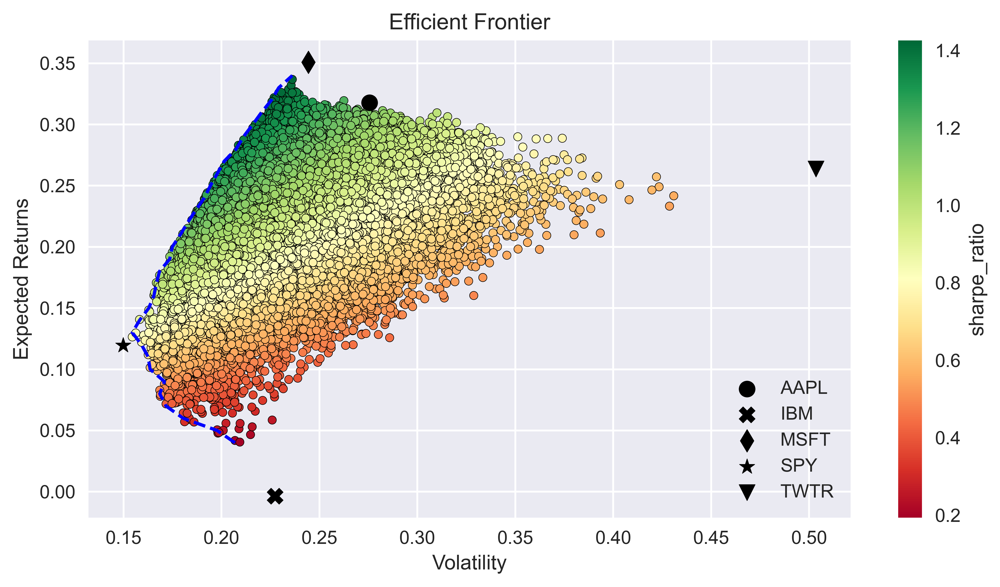

In [105]:
MARKS = ['o', 'X', 'd', '*','v']

fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.plot(portf_vol_ef, portf_rtns_ef, 'b--')
for asset_index in range(n_assets):
    ax.scatter(x=np.sqrt(cov_mat.iloc[asset_index, asset_index]), 
                y=avg_returns[asset_index], 
                marker=MARKS[asset_index], 
                s=75, 
                color='black',
                label=RISKY_ASSETS[asset_index])
ax.legend()

plt.tight_layout()
#plt.savefig('images/ch7_im8.png')
plt.show()

### There's more

In [55]:
max_sharpe_ind = np.argmax(portf_results_df.sharpe_ratio)
max_sharpe_portf = portf_results_df.loc[max_sharpe_ind]

min_vol_ind = np.argmin(portf_results_df.volatility)
min_vol_portf = portf_results_df.loc[min_vol_ind]

In [56]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')
for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmax(portf_results_df.sharpe_ratio)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
returns: 33.68% volatility: 23.62% sharpe_ratio: 142.62% 
Weights
AAPL: 8.09% IBM: 0.78% MSFT: 85.22% SPY: 2.42% TWTR: 3.50% 

In [57]:
print('Minimum Volatility portfolio ----')
print('Performance')
for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)
print('\nWeights')
for x, y in zip(RISKY_ASSETS, weights[np.argmin(portf_results_df.volatility)]):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
returns: 12.65% volatility: 15.45% sharpe_ratio: 81.87% 
Weights
AAPL: 3.67% IBM: 6.80% MSFT: 3.43% SPY: 86.08% TWTR: 0.02% 

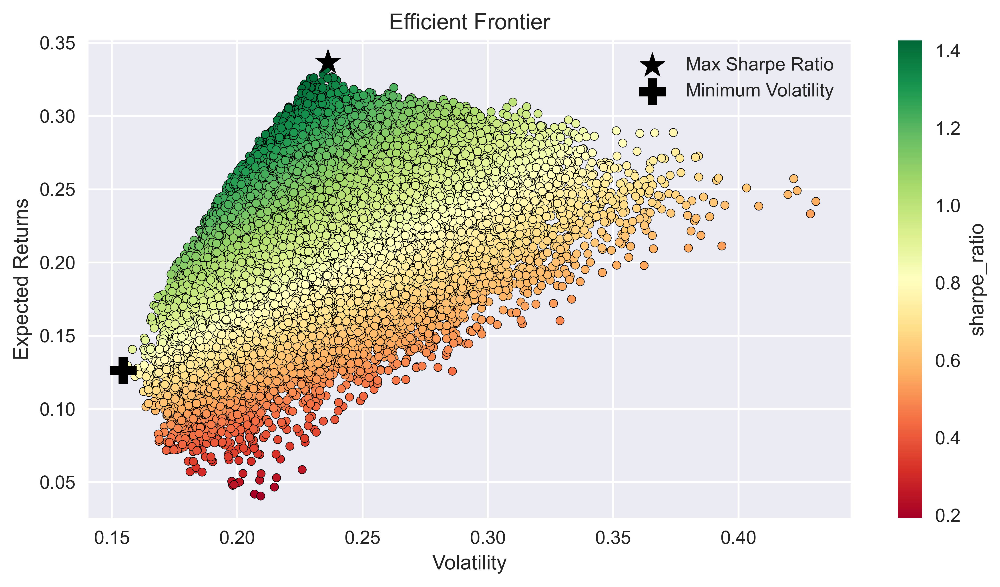

In [59]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.scatter(x=max_sharpe_portf.volatility, 
           y=max_sharpe_portf.returns, 
           c='black', marker='*', 
           s=200, label='Max Sharpe Ratio')
ax.scatter(x=min_vol_portf.volatility, 
           y=min_vol_portf.returns, 
           c='black', marker='P', 
           s=200, label='Minimum Volatility')
ax.set(xlabel='Volatility', ylabel='Expected Returns', 
       title='Efficient Frontier')
ax.legend()

plt.tight_layout()
#plt.savefig('images/ch7_im11.png')
plt.show()

## Finding the Efficient Frontier using optimization with scipy

### Getting Ready

This recipe requires running all the code from the recipe *Finding the Efficient Frontier using Monte Carlo simulations*.

### How to do it...

1. Import the libraries:

In [60]:
import numpy as np
import scipy.optimize as sco

2. Define functions calculating portfolio returns and volatility:

In [61]:
def get_portf_rtn(w, avg_rtns):
    return np.sum(avg_rtns * w)

def get_portf_vol(w, avg_rtns, cov_mat):
    return np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))

3. Define the function calculating the efficient frontier:

In [62]:
def get_efficient_frontier(avg_rtns, cov_mat, rtns_range):
    
    efficient_portfolios = []
    
    n_assets = len(avg_returns)
    args = (avg_returns, cov_mat)
    bounds = tuple((0,1) for asset in range(n_assets))
    initial_guess = n_assets * [1. / n_assets, ]
    
    for ret in rtns_range:
        constraints = ({'type': 'eq', 
                        'fun': lambda x: get_portf_rtn(x, avg_rtns) - ret},
                       {'type': 'eq', 
                        'fun': lambda x: np.sum(x) - 1})
        efficient_portfolio = sco.minimize(get_portf_vol, initial_guess, 
                                           args=args, method='SLSQP', 
                                           constraints=constraints,
                                           bounds=bounds)
        efficient_portfolios.append(efficient_portfolio)
    
    return efficient_portfolios

4. Define the considered range of returns:

In [85]:
#rtns_range = np.linspace(-0.22, 0.32, 200)
rtns_range = np.linspace(-0.002, 0.35, 200)

5. Calculate the Efficient Frontier:

In [86]:
efficient_portfolios = get_efficient_frontier(avg_returns, 
                                              cov_mat, 
                                              rtns_range)

6. Extract the volatilities of the efficient portfolios:

In [87]:
vols_range = [x['fun'] for x in efficient_portfolios]

7. Plot the calculated Efficient Frontier, together with the simulated portfolios:

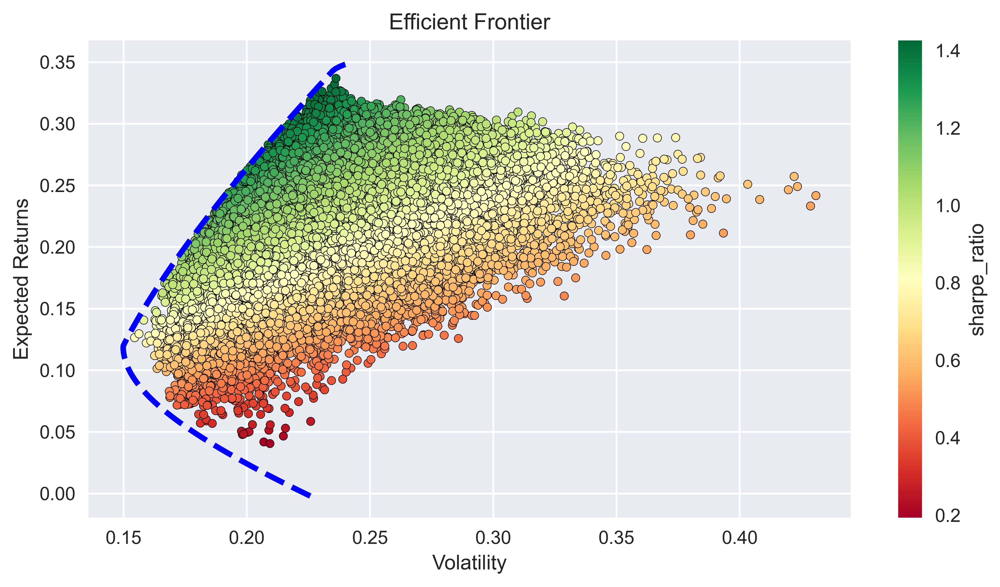

In [88]:
fig, ax = plt.subplots()
portf_results_df.plot(kind='scatter', x='volatility', 
                      y='returns', c='sharpe_ratio',
                      cmap='RdYlGn', edgecolors='black', 
                      ax=ax)
ax.plot(vols_range, rtns_range, 'b--', linewidth=3)
ax.set(xlabel='Volatility', 
       ylabel='Expected Returns', 
       title='Efficient Frontier')

plt.tight_layout()
#plt.savefig('images/ch7_im12.png')
plt.show()

8. Identify the minimum volatility portfolio:

In [68]:
min_vol_ind = np.argmin(vols_range)
min_vol_portf_rtn = rtns_range[min_vol_ind]
min_vol_portf_vol = efficient_portfolios[min_vol_ind]['fun']

min_vol_portf = {'Return': min_vol_portf_rtn,
                 'Volatility': min_vol_portf_vol,
                 'Sharpe Ratio': (min_vol_portf_rtn / 
                                  min_vol_portf_vol)}

min_vol_portf

{'Return': 0.11919597989949751,
 'Volatility': 0.149811817871913,
 'Sharpe Ratio': 0.7956380317166193}

9. Print performance summary:

In [69]:
print('Minimum Volatility portfolio ----')
print('Performance')

for index, value in min_vol_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, efficient_portfolios[min_vol_ind]['x']):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Minimum Volatility portfolio ----
Performance
Return: 11.92% Volatility: 14.98% Sharpe Ratio: 79.56% 
Weights
AAPL: 0.00% IBM: 0.33% MSFT: 0.00% SPY: 99.67% TWTR: 0.00% 

### There's more

1. Define the objective function:

In [70]:
def neg_sharpe_ratio(w, avg_rtns, cov_mat, rf_rate):
    portf_returns = np.sum(avg_rtns * w)
    portf_volatility = np.sqrt(np.dot(w.T, np.dot(cov_mat, w)))
    portf_sharpe_ratio = (portf_returns - rf_rate) / portf_volatility
    return -portf_sharpe_ratio

2. Find the optimized portfolio:

In [71]:
n_assets = len(avg_returns)
RF_RATE = 0

args = (avg_returns, cov_mat, RF_RATE)
constraints = ({'type': 'eq', 
                'fun': lambda x: np.sum(x) - 1})
bounds = tuple((0,1) for asset in range(n_assets))
initial_guess = n_assets * [1. / n_assets]

max_sharpe_portf = sco.minimize(neg_sharpe_ratio, 
                                x0=initial_guess, 
                                args=args,
                                method='SLSQP', 
                                bounds=bounds, 
                                constraints=constraints)

3. Extract information about the maximum Sharpe Ratio portfolio:

In [72]:
max_sharpe_portf_w = max_sharpe_portf['x']
max_sharpe_portf = {'Return': get_portf_rtn(max_sharpe_portf_w, 
                                            avg_returns),
                    'Volatility': get_portf_vol(max_sharpe_portf_w, 
                                                avg_returns, 
                                                cov_mat),
                    'Sharpe Ratio': -max_sharpe_portf['fun']}
max_sharpe_portf

{'Return': 0.3439860666751506,
 'Volatility': 0.23546443296803396,
 'Sharpe Ratio': 1.4608833374076893}

4. Print performance summary:

In [73]:
print('Maximum Sharpe Ratio portfolio ----')
print('Performance')

for index, value in max_sharpe_portf.items():
    print(f'{index}: {100 * value:.2f}% ', end="", flush=True)

print('\nWeights')
for x, y in zip(RISKY_ASSETS, max_sharpe_portf_w):
    print(f'{x}: {100*y:.2f}% ', end="", flush=True)

Maximum Sharpe Ratio portfolio ----
Performance
Return: 34.40% Volatility: 23.55% Sharpe Ratio: 146.09% 
Weights
AAPL: 21.00% IBM: 0.00% MSFT: 79.00% SPY: 0.00% TWTR: 0.00% 